# Data Generation with Mitsuba

Based on **Benedikt Bitterli's Rendering resources** (https://benedikt-bitterli.me/resources/) and (https://mitsuba.readthedocs.io/en/stable/src/gallery.html=) 32 different 3D scenes have been rendered with Mitsuba 3.

The generated data consists of histograms of radiance per pixel collected over several iterations of monte carlo ray tracing with 1 spp.

In [13]:
!pip install mitsuba==3.6.4 drjit==1.0.5 numpy matplotlib scikit-learn

In [14]:
# Data Processing + Utils
import zipfile
import tifffile
import tempfile
import numpy as np
from pathlib import Path

# Mitsuba Renderer
import mitsuba as mi
mi.set_variant("scalar_rgb")
# "cuda_ad_rgb" for GPU or "llvm_ad_rgb" for vectorised and "scalar_rgb" (default) for CPU

# Image Processing and Visialisation
import matplotlib.pyplot as plt

# PSNR
from skimage.metrics import peak_signal_noise_ratio

In [15]:
print(f"""
Library Version Sanity Check
Mitsuba:     {mi.__version__} (Expected: 3.6.4)
""")


Library Version Sanity Check
Mitsuba:     3.6.4 (Expected: 3.6.4)



## Configuration

In [16]:
NUM_BINS = 16
RANGE_VAL = 10

LOW_SPP = 10        # 32
HIGH_SPP = 50       # 1000

# Image resolution 
WIDTH = 512
HEIGHT = 512

TEST_SPLIT = 0.2

LOG_BIN = False
DEBUG = False

# PATHS
input_path = "data"
output_path = "output"
train_data_path = "data/train"
test_data_path = "data/test"
SCENE_ROOT = Path(input_path)
TRAIN_ROOT = Path(train_data_path)
TEST_ROOT = Path(test_data_path)
OUTPUT_DIR = Path(output_path)
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

## Data Loaders

**Data Loaders** from **zip** and **dir**

In [17]:
def extract_scene_zip(zip_path):
    """
    Extracts a zip file to a temporary directory

    Parameters:
    - zip_path (str): path to the zip file

    Returns:
    - temp_dir (str): path to the extracted directory
    """
    temp_dir = tempfile.mkdtemp()
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(temp_dir)
    return temp_dir

In [18]:
def load_scene_xml(scene_dir):
    """
    Loads a scene from .xml file with Mitsuba

    Parameters:
    - scene_dir (str): folder containing files of a scene

    Returns:
    - scene (Mitsuba Scene)
    """
    scene_dir = Path(scene_dir)
    xml_files = [
        f for f in scene_dir.rglob("*.xml")                           # recursive search
        if not f.name.startswith("._") and "__MACOSX" not in str(f)   # filter out metadata files on Mac
    ]

    if not xml_files:
        raise FileNotFoundError(f"No valid XML scene found in {scene_dir}")

    return mi.load_file(str(xml_files[0]))

# Load Data
- Single scene for testing
- Train/test datasets

In [19]:
# SINGLE IMAGE
one_scene = ["data/train/banner_01"]

# Scene Processing Pipeline

- Noisy Images (LOW_SPP)
- Clean Ground Truth Images (HIGH_SPP)

In [20]:
def plot_images(clean_image, noisy_image):
  """
  NOISY vs. CLEAN Visualisation

  Parameters:
  - clean_image (np array): clean image of shape (H, W, C)
  - noisy_image (np array): noisy image of shape (H, W, C) = average from histograms
  """
  print("Clean Image: ", clean_image.shape)
  print("Average from Histogram: ", noisy_image.shape)

  plt.figure(figsize=(12,5))

  # CLEAN IMAGE
  plt.subplot(1,2,1)
  plt.title("Clean Scene")
  plt.imshow(np.clip(clean_image, 0, 1))
  plt.axis('off')

  # AGERAGE FROM HISTOGRAM
  plt.subplot(1,2,2)
  plt.title("Histogram Avg Patch (Low spp)")
  plt.imshow(np.clip(noisy_image, 0, 1))
  plt.axis('off')

  plt.tight_layout()
  plt.show()

In [21]:
def save_tiff(data, file_name):
  """
  Saves data of shape (N, H, W, C, B) to TIFF file using BigTIFF if needed.

  Parameters:
  - data (np array): data to save
  - file_name (str): file name / scene name
  """
  tifffile.imwrite(file_name, data, compression='lzw', bigtiff=True)
  print(f"Saved {file_name} with shape {data.shape} <3")

**PSNR** / **Image Quality**
- 20 dB = Poor	
- 20/30 dB = Fair to decent
- 30/40 dB = Good
- \>40 dB	= Excellent

In [28]:
def calculate_psnr_rgb(low_img_tensor, high_img_tensor):
    """Load RGB TIFFs and compute PSNR between low- and high-spp images."""
    # Automatically determine max intensity from high quality reference
    low_img = mi.TensorXf(low_img_tensor).numpy()
    high_img = mi.TensorXf(high_img_tensor).numpy()

    data_range = np.max(high_img)

    psnr = peak_signal_noise_ratio(high_img, low_img, data_range=data_range)
    print(f"PSNR: {psnr} !!!")

In [26]:
def render_scene(scene_path, output_dir=OUTPUT_DIR, low_spp=LOW_SPP, high_spp=HIGH_SPP):
    scene = mi.load_file(str(scene_path))
    sensor = scene.sensors()[0]
    integrator = scene.integrator()

    output_dir.mkdir(parents=True, exist_ok=True)

    # Get parts for filename
    scene_folder_name = scene_path.parent.name
    xml_name = scene_path.stem  # filename without extension
    print(f"Rendering {scene_path.name} .....")

    # LOW SPP
    img_low = mi.render(scene, sensor=sensor, integrator=integrator, spp=low_spp)
    low_out_path = output_dir / f"{scene_folder_name}_{xml_name}_spp{low_spp}.tiff"
    save_tiff(img_low, low_out_path)

    # HIGH SPP
    img_high = mi.render(scene, sensor=sensor, integrator=integrator, spp=high_spp)
    high_out_path = output_dir / f"{scene_folder_name}_{xml_name}_spp{high_spp}.tiff"
    save_tiff(img_high, high_out_path)
    
    calculate_psnr_rgb(img_low, img_high)
    plot_images(img_high, img_low)

In [24]:
def process_dataset(root_folder, output_root):
    """
    Process all scene folders inside root_folder.
    Expects scene XML files inside each folder.
    """
    scene_folders = sorted([d for d in root_folder.iterdir() if d.is_dir()])
    print(f"Found {len(scene_folders)} scene folders in {root_folder}")

    for scene_dir in scene_folders:
        # Find all XML files in this scene folder (usually one or more)
        xml_files = sorted(scene_dir.glob("*.xml"))
        if not xml_files:
            print(f"No XML files found in {scene_dir}, skipping.")
            continue

        # Create corresponding output folder (same relative structure)
        relative_path = scene_dir.relative_to(root_folder)
        output_dir = output_root / relative_path
        output_dir.mkdir(parents=True, exist_ok=True)

        for xml_file in xml_files:
            render_scene(xml_file, output_dir)

# TRAIN & TEST SCENE GENERATION

Found 6 scene folders in data/test
Rendering scene.xml .....
Saved output/test/banner_01/banner_01_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/banner_01/banner_01_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 26.87062779356854 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


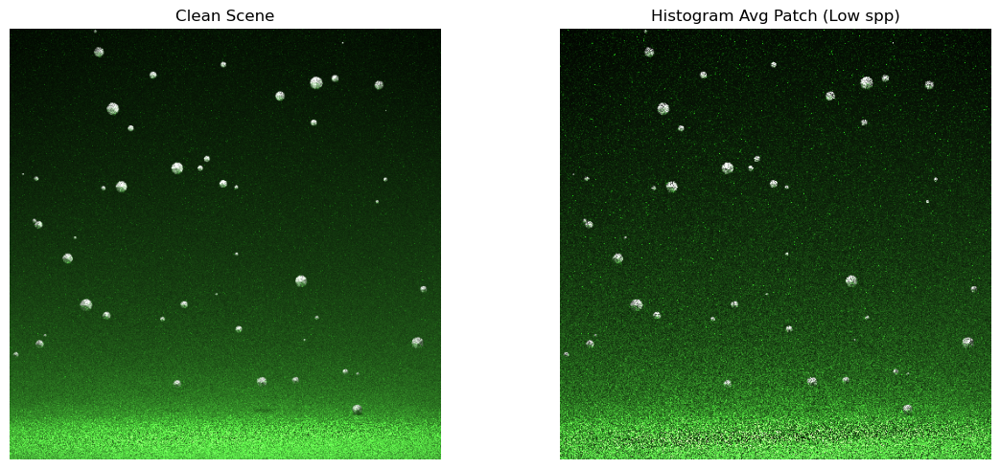

Rendering scene.xml .....
Saved output/test/bathroom2/bathroom2_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/bathroom2/bathroom2_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 44.11573665403188 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


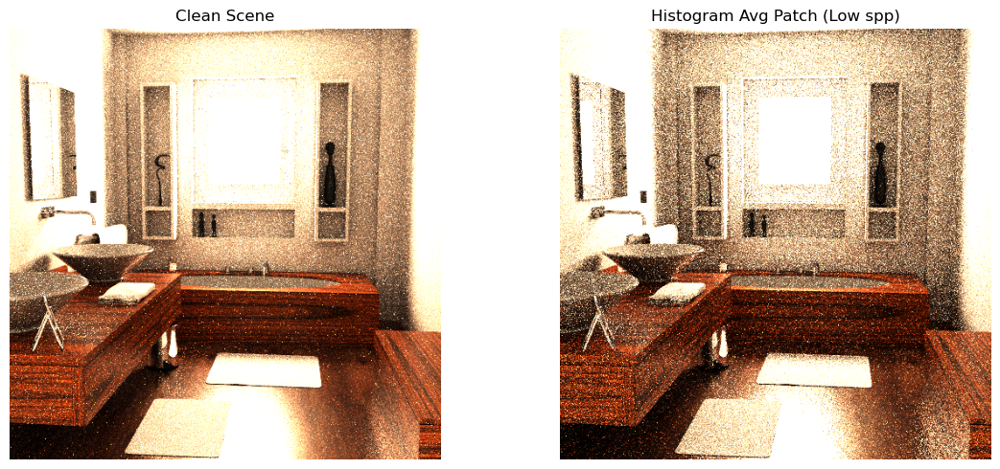

Rendering scene.xml .....
Saved output/test/classroom/classroom_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/classroom/classroom_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 36.67566556197751 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


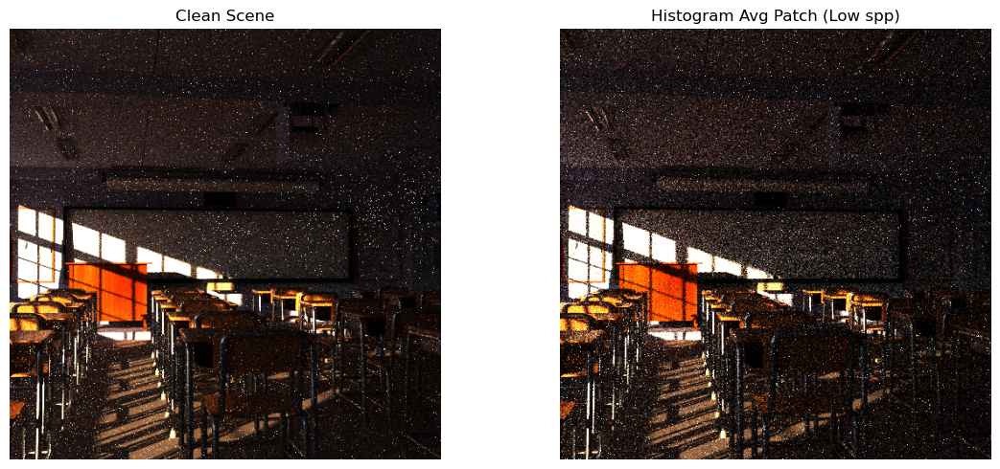

Rendering scene.xml .....
Saved output/test/cornell-box/cornell-box_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/cornell-box/cornell-box_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 53.64773556849683 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


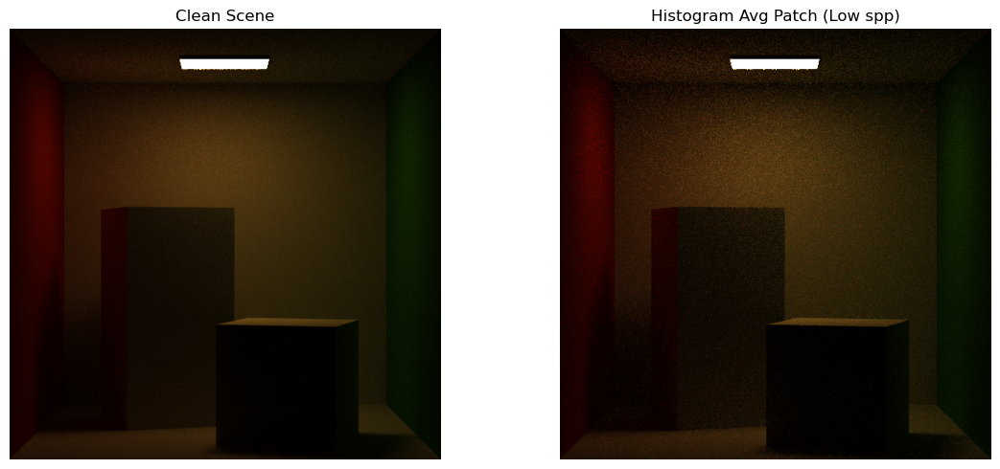

Rendering scene.xml .....
Saved output/test/living-room-3/living-room-3_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/living-room-3/living-room-3_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 27.331710322749743 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


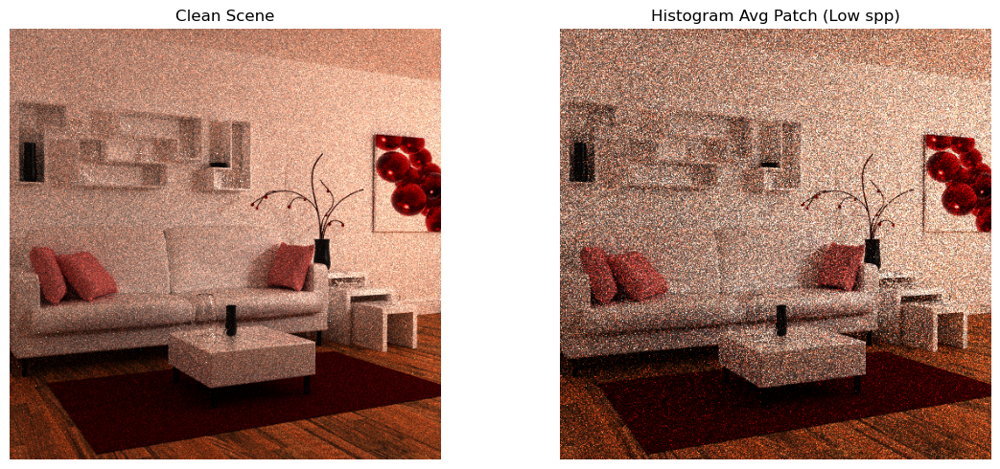

Rendering scene.xml .....
Saved output/test/teapot-full/teapot-full_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/test/teapot-full/teapot-full_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 41.9889519453315 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


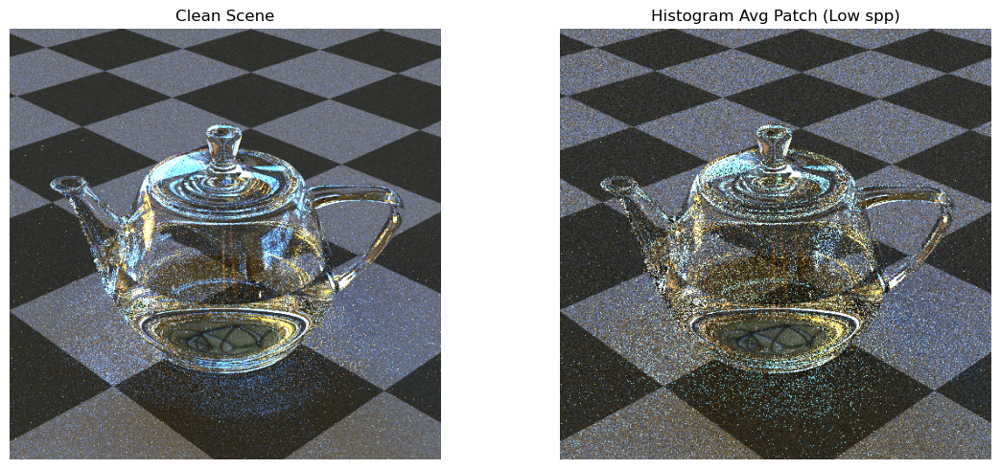

In [29]:
# Run for train and test
process_dataset(TEST_ROOT, OUTPUT_DIR / "test")

Found 21 scene folders in data/train
Rendering scene.xml .....
Saved output/train/banner_02/banner_02_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/banner_02/banner_02_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 35.58114737053079 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


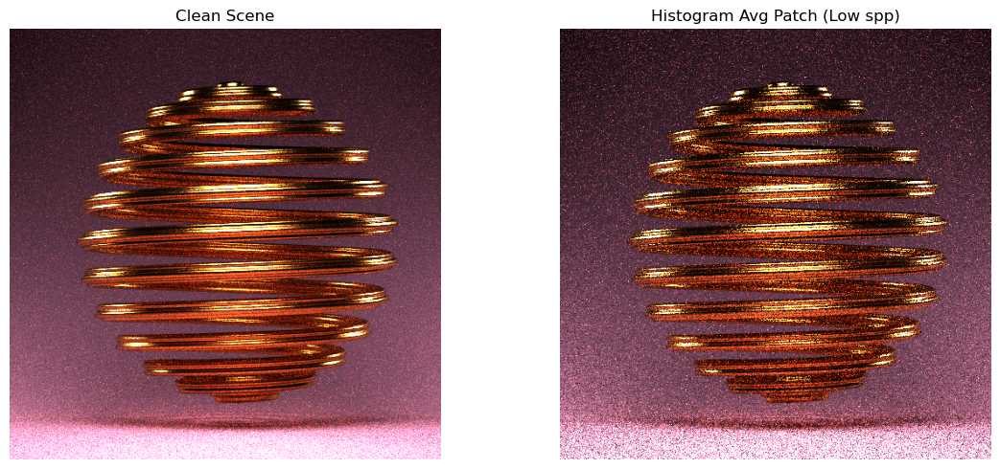

Rendering scene.xml .....
Saved output/train/banner_04/banner_04_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/banner_04/banner_04_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 21.743045097353082 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


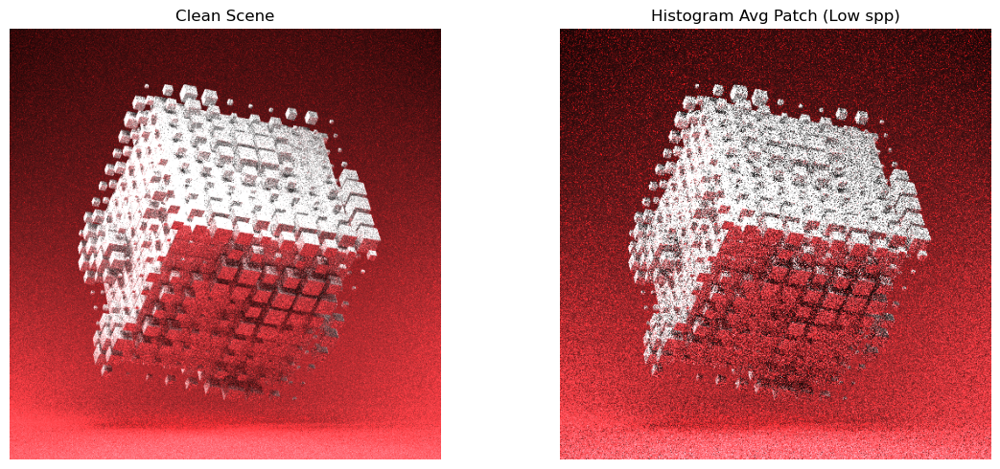

Rendering scene.xml .....
Saved output/train/banner_05/banner_05_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/banner_05/banner_05_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 24.47663817717673 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


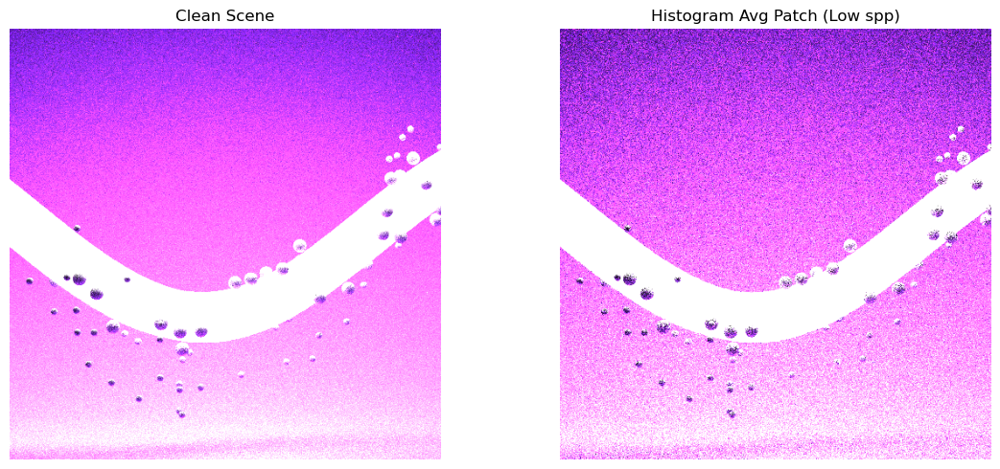

Rendering scene.xml .....
Saved output/train/banner_07/banner_07_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/banner_07/banner_07_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 37.67589592099776 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


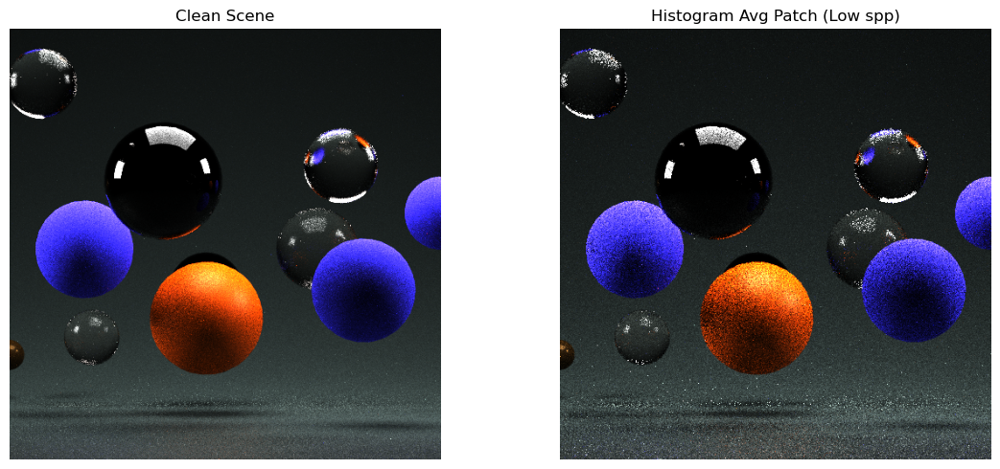

Rendering scene.xml .....
Saved output/train/bathroom/bathroom_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/bathroom/bathroom_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 28.088633388655225 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


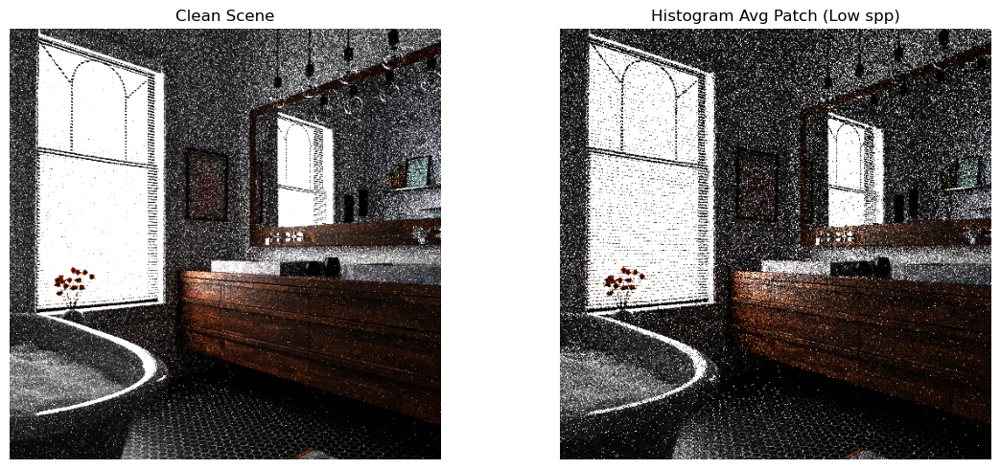

Rendering scene.xml .....
Saved output/train/bedroom/bedroom_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/bedroom/bedroom_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 26.74149374410176 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


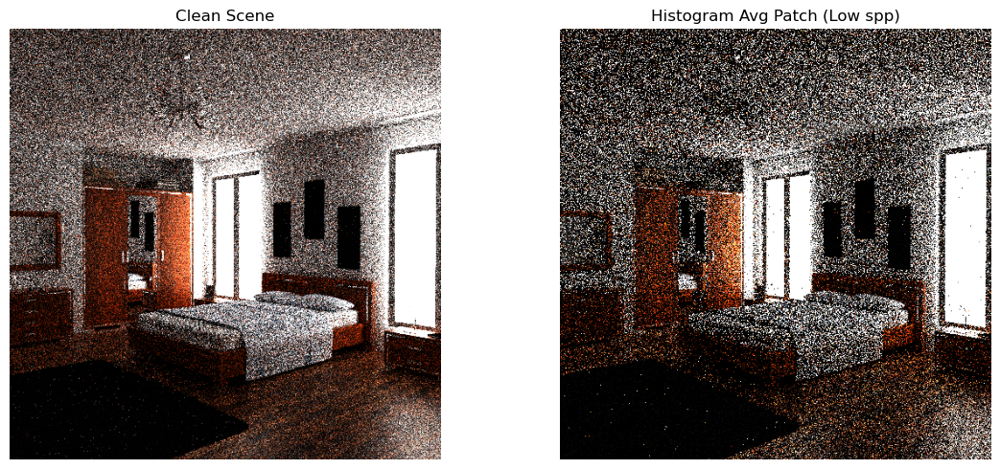

Rendering scene.xml .....
Saved output/train/dining-room/dining-room_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/dining-room/dining-room_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 45.29627972256872 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


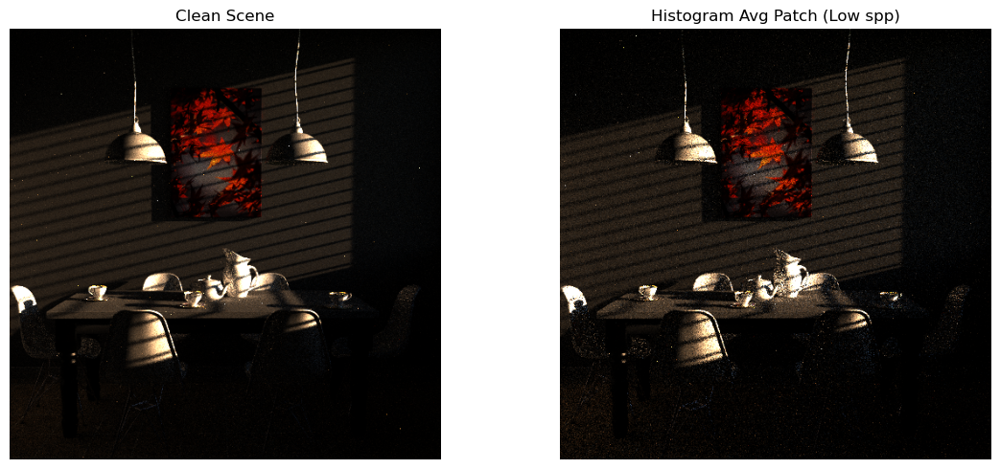

Rendering scene.xml .....
Saved output/train/glass-of-water/glass-of-water_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/glass-of-water/glass-of-water_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 37.57763124081479 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


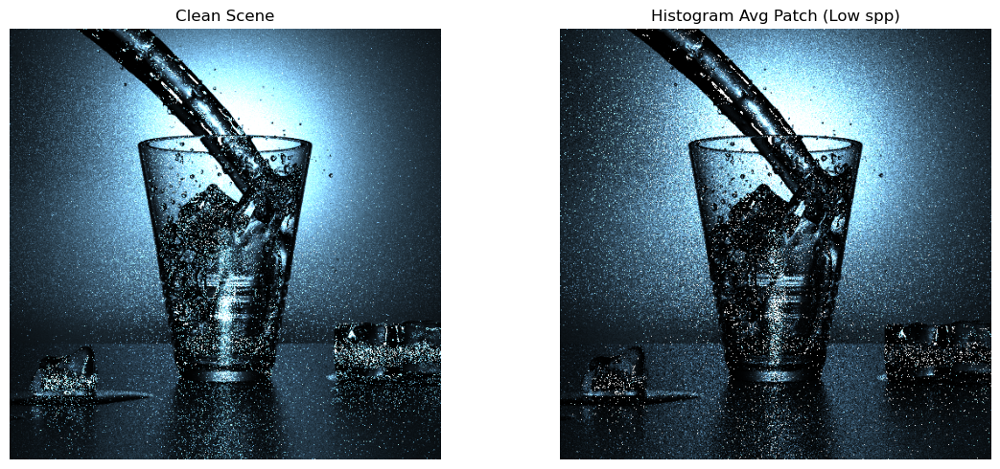

Rendering scene-above.xml .....
Saved output/train/house/house_scene-above_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/house/house_scene-above_spp50.tiff with shape (512, 512, 3) <3
PSNR: 32.58880451486527 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


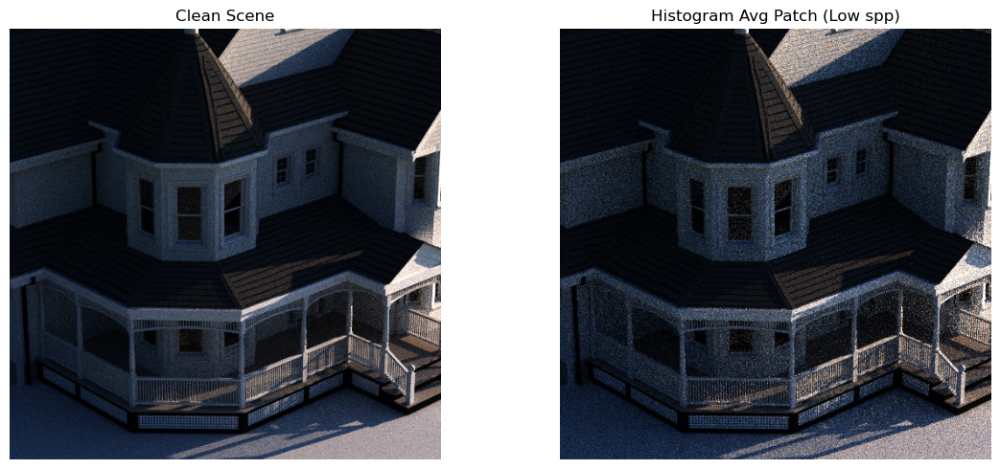

Rendering scene.xml .....
Saved output/train/house/house_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/house/house_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 35.62445016087143 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


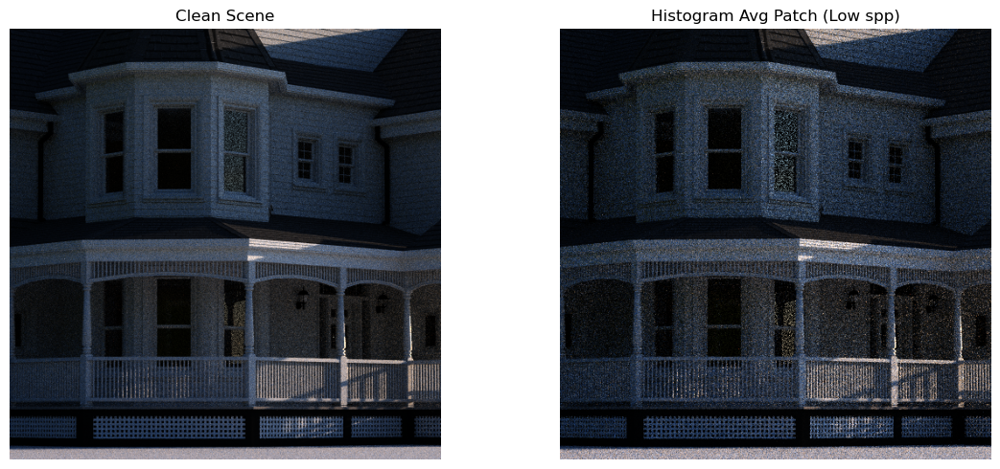

Rendering scene.xml .....
Saved output/train/kitchen/kitchen_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/kitchen/kitchen_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 32.74508652289383 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


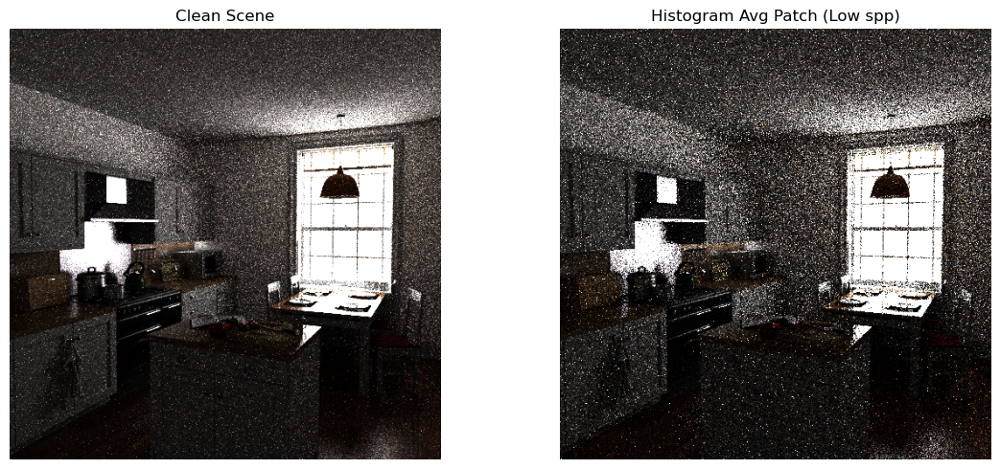

Rendering scene-above.xml .....
Saved output/train/lamp/lamp_scene-above_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/lamp/lamp_scene-above_spp50.tiff with shape (512, 512, 3) <3
PSNR: 30.195280061933087 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


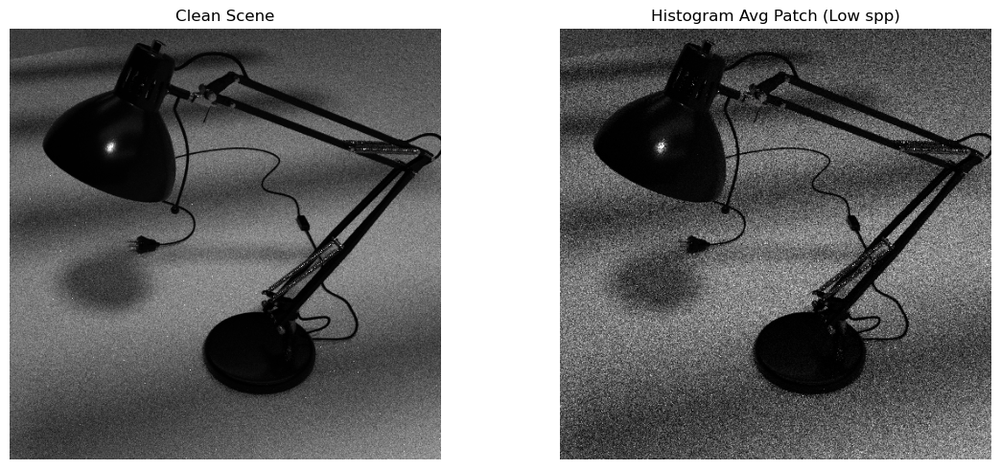

Rendering scene.xml .....
Saved output/train/lamp/lamp_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/lamp/lamp_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 29.16675977624503 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


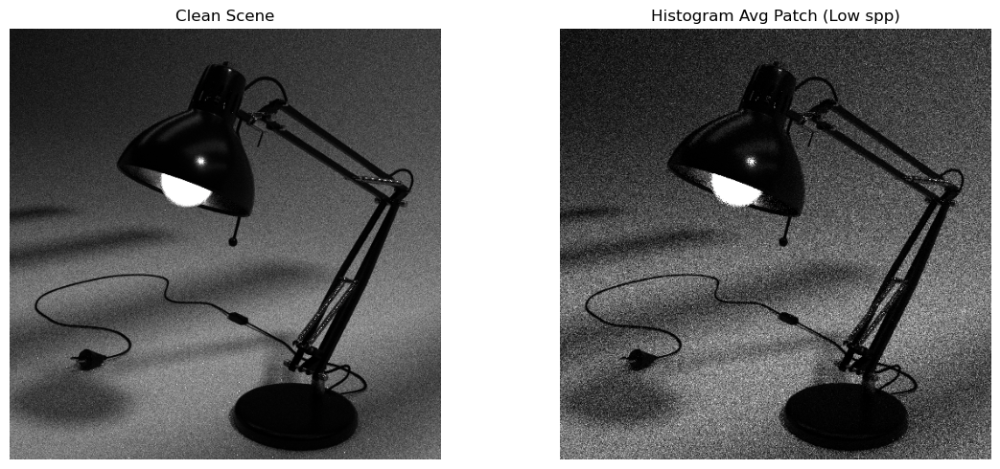

Rendering scene.xml .....
Saved output/train/living-room/living-room_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/living-room/living-room_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 44.862203119826056 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


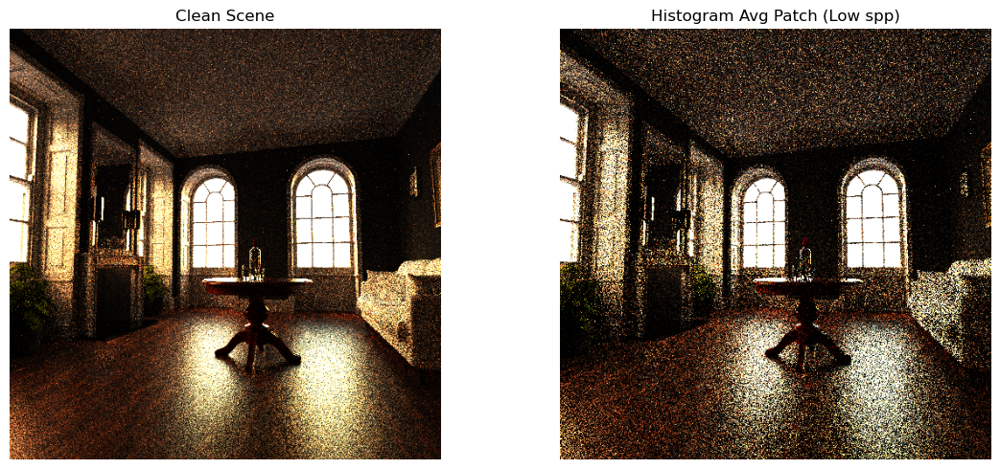

Rendering scene.xml .....
Saved output/train/living-room-2/living-room-2_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/living-room-2/living-room-2_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 36.86240696532438 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


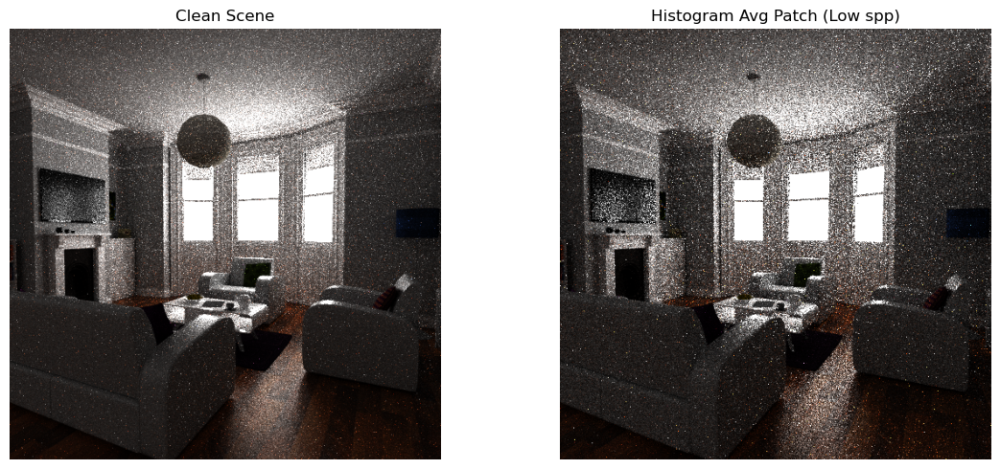

Rendering scene-above.xml .....
Saved output/train/matpreview/matpreview_scene-above_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/matpreview/matpreview_scene-above_spp50.tiff with shape (512, 512, 3) <3
PSNR: 34.74314301330318 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


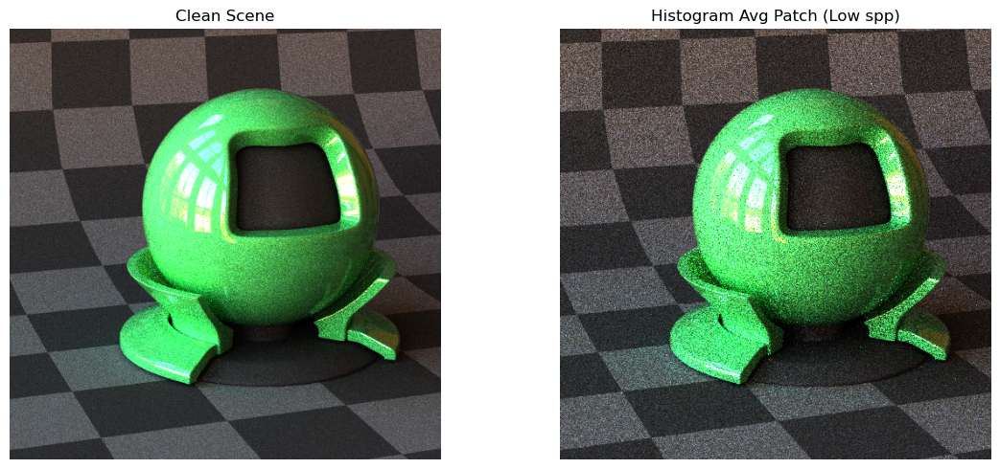

Rendering scene.xml .....
Saved output/train/matpreview/matpreview_scene_spp10.tiff with shape (512, 683, 3) <3
Saved output/train/matpreview/matpreview_scene_spp50.tiff with shape (512, 683, 3) <3
PSNR: 33.37289168484689 !!!
Clean Image:  (512, 683, 3)
Average from Histogram:  (512, 683, 3)


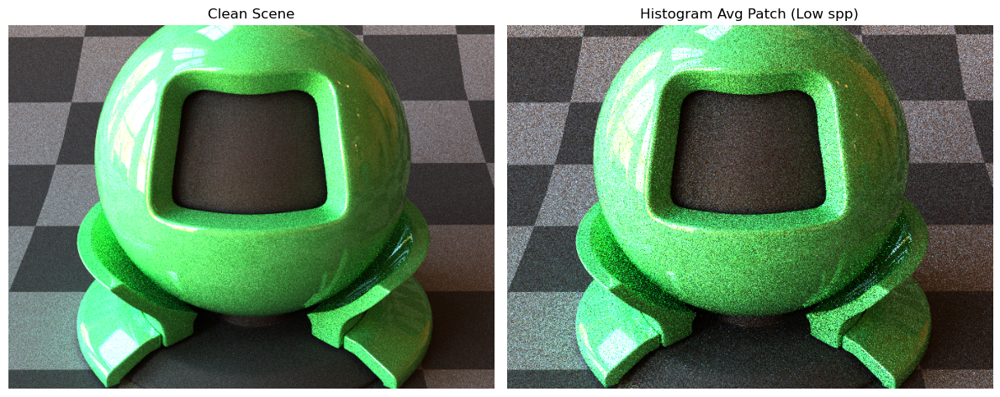

Rendering scene.xml .....
Saved output/train/spaceship/spaceship_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/spaceship/spaceship_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 44.61375151457756 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


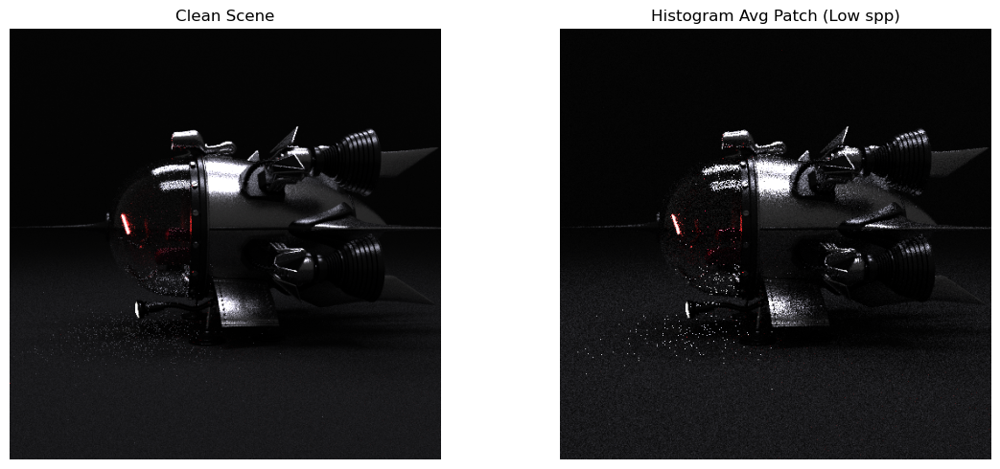

Rendering scene.xml .....
Saved output/train/staircase/staircase_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/staircase/staircase_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 39.82701498455386 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


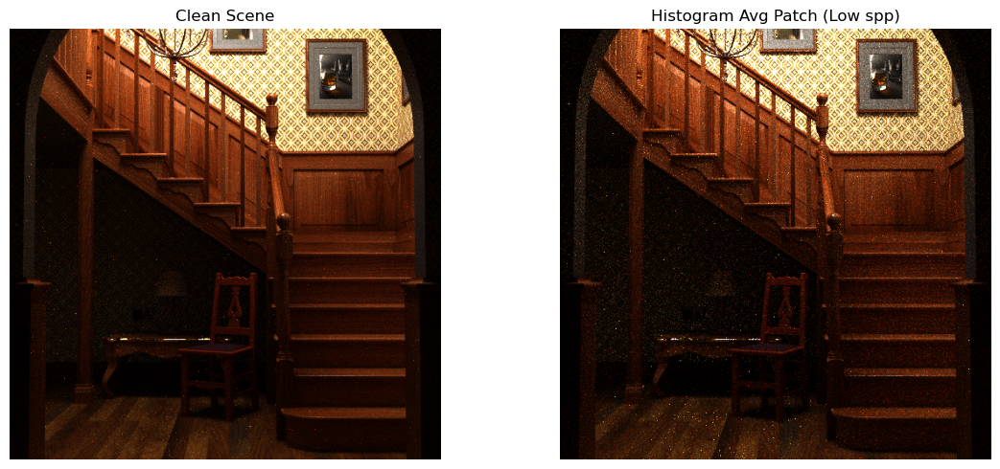

Rendering scene.xml .....
Saved output/train/staircase2/staircase2_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/staircase2/staircase2_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 26.098916787359897 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


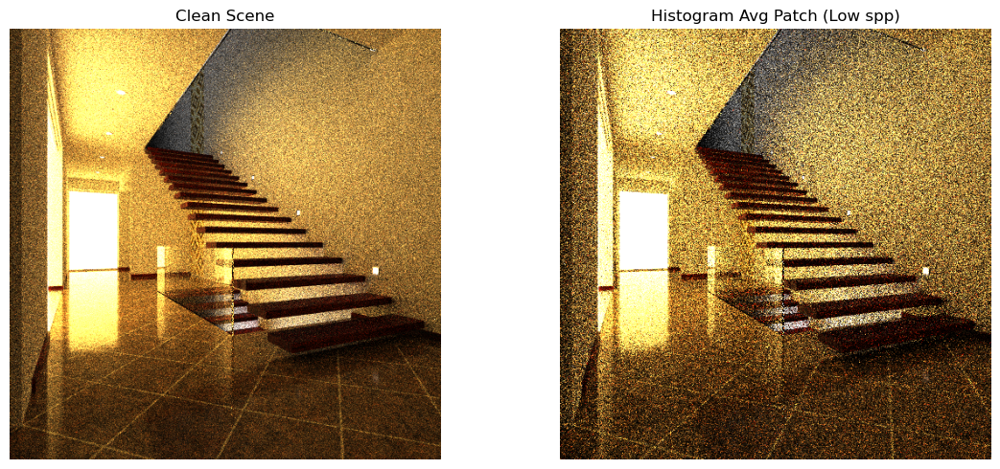

Rendering scene.xml .....
Saved output/train/veach-ajar/veach-ajar_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/veach-ajar/veach-ajar_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 23.902798754745895 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


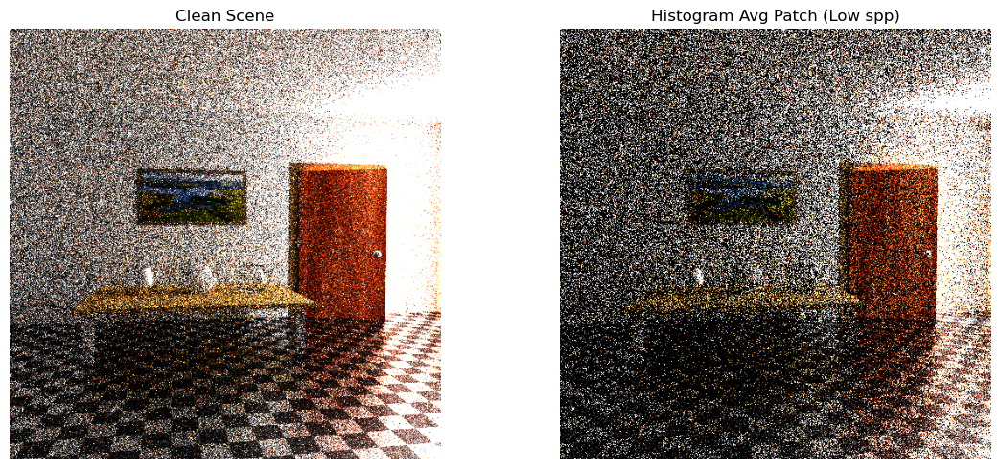

Rendering scene.xml .....
Saved output/train/veach-bidir/veach-bidir_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/veach-bidir/veach-bidir_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 45.91911865185843 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


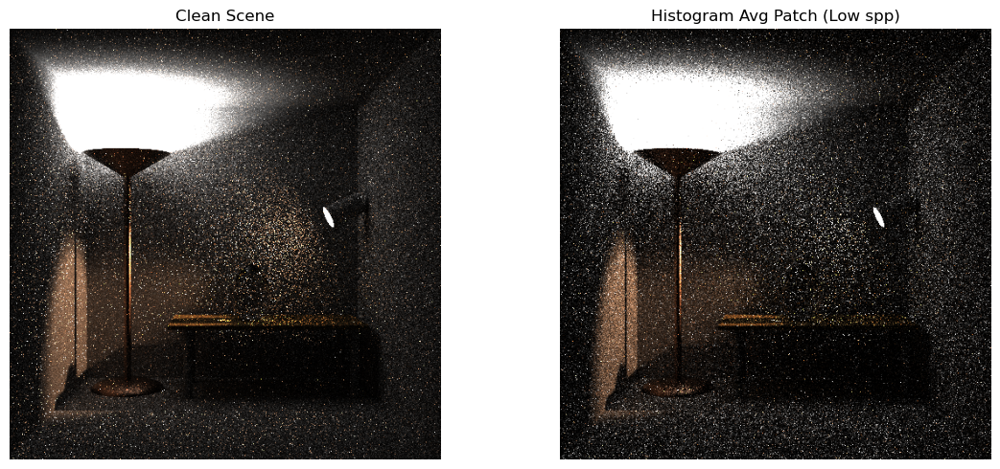

Rendering scene.xml .....
Saved output/train/veach-mis/veach-mis_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/veach-mis/veach-mis_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 59.839565859508795 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


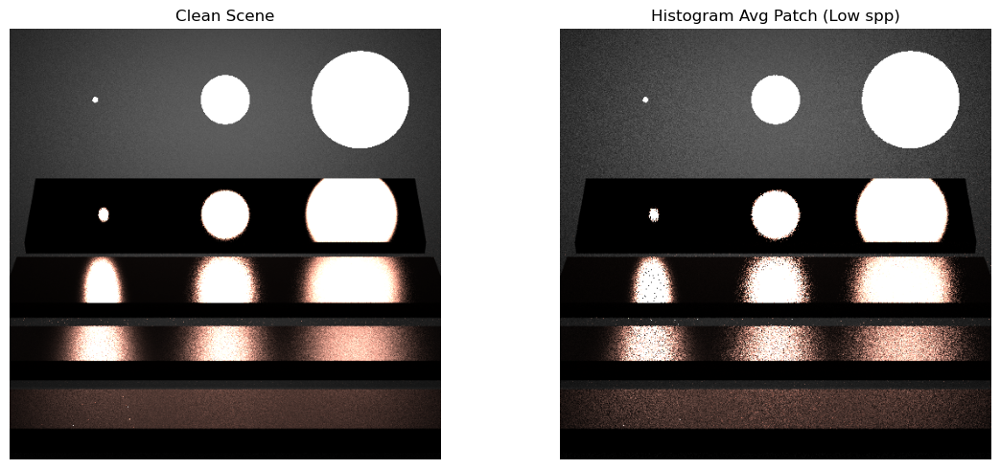

Rendering scene.xml .....
Saved output/train/volumetric-caustic/volumetric-caustic_scene_spp10.tiff with shape (512, 512, 3) <3
Saved output/train/volumetric-caustic/volumetric-caustic_scene_spp50.tiff with shape (512, 512, 3) <3
PSNR: 58.260668122055804 !!!
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


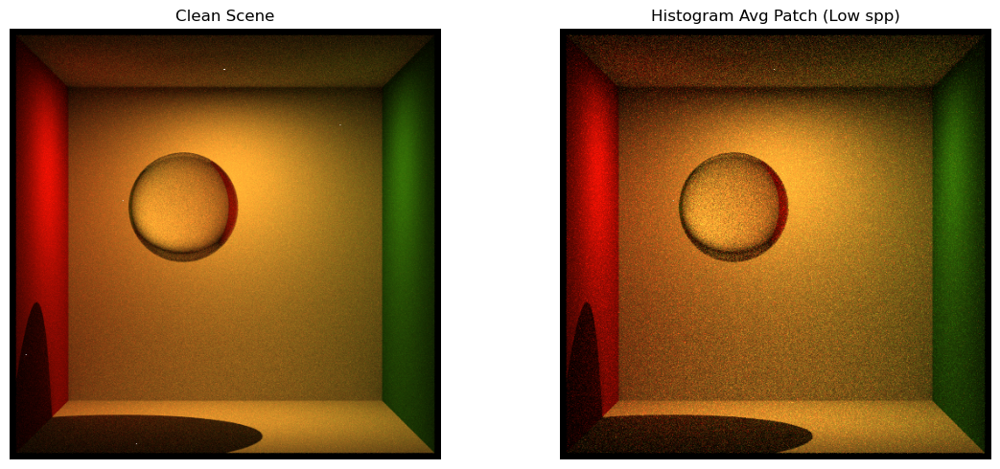

In [30]:
process_dataset(TRAIN_ROOT, OUTPUT_DIR / "train")